#1.Installing Dependencies

In [1]:
!pip install tensorflow-addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 9.0 MB/s eta 0:00:00


In [2]:
!pip install -q gradio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 52.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.1/92.1 kB 12.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 312.4/312.4 kB 36.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.8/144.8 kB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 102.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 18.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.5/71.5 kB 10.8 MB/s eta 0:00:00


#2.Importing Library

In [3]:
import os
import random

import re
from collections import defaultdict,Counter

from tqdm import tqdm
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer

import tensorflow
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import  pad_sequences
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout, LSTMCell, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard, ReduceLROnPlateau, TensorBoard
import tensorflow_addons as tfa
import pickle

import nltk
import nltk.translate.gleu_score as gleu
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer,PorterStemmer
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud, STOPWORDS

import gradio as gr
from prettytable import PrettyTable
import time

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
%cd /content/drive/MyDrive/Grammatical_Error_Correction

/content/drive/MyDrive/Grammatical_Error_Correction


#3.Data Preprocessing and EDA

In [7]:
CSV_DIR = './Data/csv_data'
CSV_BEA = 'bea19'
CSV_C4 = 'c4_200m'

In [8]:
df = pd.read_csv(os.path.join(CSV_DIR, CSV_C4, 'data.csv'))

In [ ]:
df.head()

,input,target
0,The effect of widespread dud targets two face ...,The effect of widespread dud targets two face ...
1,tax on sales of stores for non residents are s...,Capital Gains tax on the sale of properties fo...
2,Much many brands and sellers still in the market,Many brands and sellers still in the market
3,this is is the latest Maintenance release of S...,This is is the latest maintenance release of S...
4,Fairy Or Not I am the Godmother no just look b...,Fairy Or Not I am the Godmother Not just a loo...


In [9]:
'''THIS FUNCTION REMOVES THE SPACES BETWEEN THE CONTRACTED WORDS AND REMOVING UNNECESSARY SPACES IN THE SENTENCES
            ca n't ==> can't
            I 'm ===> I'm ...etc
'''
def remove_spaces(text):
    text = re.sub(r" '(\w)",r"'\1",text)
    text = re.sub(r" \,",",",text)
    text = re.sub(r" \.+",".",text)
    text = re.sub(r" \!+","!",text)
    text = re.sub(r" \?+","?",text)
    text = re.sub(" n't","n't",text)
    text = re.sub("[\(\)\;\_\^\`\/]","",text)

    return text


'''THIS FUNCTION DECONTRACTS THE CONTRACTED WORDS'''
contractions_dict = { "ain't": "are not","'s":" is","aren't": "are not",
                     "can't": "cannot","can't've": "cannot have",
                     "'cause": "because","could've": "could have","couldn't": "could not",
                     "couldn't've": "could not have", "didn't": "did not","doesn't": "does not",
                     "don't": "do not","hadn't": "had not","hadn't've": "had not have",
                     "hasn't": "has not","haven't": "have not","he'd": "he would",
                     "he'd've": "he would have","he'll": "he will", "he'll've": "he will have",
                     "how'd": "how did","how'd'y": "how do you","how'll": "how will",
                     "I'd": "I would", "I'd've": "I would have","I'll": "I will",
                     "I'll've": "I will have","I'm": "I am","I've": "I have", "isn't": "is not",
                     "it'd": "it would","it'd've": "it would have","it'll": "it will",
                     "it'll've": "it will have", "let's": "let us","ma'am": "madam",
                     "mayn't": "may not","might've": "might have","mightn't": "might not",
                     "mightn't've": "might not have","must've": "must have","mustn't": "must not",
                     "mustn't've": "must not have", "needn't": "need not",
                     "needn't've": "need not have","o'clock": "of the clock","oughtn't": "ought not",
                     "oughtn't've": "ought not have","shan't": "shall not","sha'n't": "shall not",
                     "shan't've": "shall not have","she'd": "she would","she'd've": "she would have",
                     "she'll": "she will", "she'll've": "she will have","should've": "should have",
                     "shouldn't": "should not", "shouldn't've": "should not have","so've": "so have",
                     "that'd": "that would","that'd've": "that would have", "there'd": "there would",
                     "there'd've": "there would have", "they'd": "they would",
                     "they'd've": "they would have","they'll": "they will",
                     "they'll've": "they will have", "they're": "they are","they've": "they have",
                     "to've": "to have","wasn't": "was not","we'd": "we would",
                     "we'd've": "we would have","we'll": "we will","we'll've": "we will have",
                     "we're": "we are","we've": "we have", "weren't": "were not","what'll": "what will",
                     "what'll've": "what will have","what're": "what are", "what've": "what have",
                     "when've": "when have","where'd": "where did", "where've": "where have",
                     "who'll": "who will","who'll've": "who will have","who've": "who have",
                     "why've": "why have","will've": "will have","won't": "will not",
                     "won't've": "will not have", "would've": "would have","wouldn't": "would not",
                     "wouldn't've": "would not have","y'all": "you all", "y'all'd": "you all would",
                     "y'all'd've": "you all would have","y'all're": "you all are",
                     "y'all've": "you all have", "you'd": "you would","you'd've": "you would have",
                     "you'll": "you will","you'll've": "you will have", "you're": "you are",
                     "you've": "you have","n\'t":" not","\'re":" are","\'s": " is","\'d":" would",
                     "\'ll": " will","\'t":" not","\'ve": " have","\'m":" am"}


# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))

# Function for expanding contractions
def expand_contractions(text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, text)


'''THIS FUNCTION PREPROCESSES THE TEXT '''
def preprocess(text):
    text = re.sub("\n","",text)
    text = remove_spaces(text)   # REMOVING UNWANTED SPACES
    text = re.sub(r"\.+",".",text)
    text = re.sub(r"\!+","!",text)
    text = expand_contractions(text)    # DECONTRACTION
    text = re.sub("[^A-Za-z0-9 ]+","",text)
    return text

In [ ]:
'''HERE WE ARE APPLYIN PREPROCESS FUNCTION TO INPUT AND OUTPUT SENTENCES'''
df.input = df.input.astype(str).apply(preprocess)
df.target = df.target.astype(str).apply(preprocess)

In [ ]:
'''THIS CELL REMOVES ROWS WITH NULL VALUES IN INPUT AND OUTPUT TEXT'''
df = df[df.input.notnull()]
df = df[df.target.notnull()]

In [ ]:
df['target_char_count'] = df['target'].astype('str').apply(lambda x:len(x))
df['input_char_count'] = df['input'].astype('str').apply(lambda x:len(x))

In [ ]:
df['target_word_count'] = df['target'].astype('str').apply(lambda x:len(x.split()))
df['input_word_count'] = df['input'].astype('str').apply(lambda x:len(x.split()))

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 192090 entries, 0 to 192089
Data columns (total 6 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   input              192090 non-null  object
 1   target             192090 non-null  object
 2   target_char_count  192090 non-null  int64 
 3   input_char_count   192090 non-null  int64 
 4   target_word_count  192090 non-null  int64 
 5   input_word_count   192090 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 10.3+ MB


In [ ]:
df.describe()

,target_char_count,input_char_count,target_word_count,input_word_count
count,192090.000000,192090.000000,192090.000000,192090.000000
mean,118.690406,118.278567,20.190744,20.185642
std,75.229015,74.491723,12.388325,12.272584
min,12.000000,12.000000,3.000000,5.000000
25%,59.000000,59.000000,10.000000,10.000000
50%,100.000000,100.000000,17.000000,17.000000
75%,162.000000,161.000000,27.000000,27.000000
max,469.000000,462.000000,62.000000,64.000000


In [ ]:
df[df.isna().any(axis=1)]

,input,target,target_char_count,input_char_count,target_word_count,input_word_count


In [ ]:
df.dropna(axis=0, how='any', inplace=True)
df.reset_index(drop=True, inplace=True)
df.shape

(192090, 6)

In [ ]:
print("Character Length Range [Input]: ")
print("Incorrect Character Range: ", (df['input_char_count'].min(),df['input_char_count'].max()))

Character Length Range [Input]: 
Incorrect Character Range:  (12, 462)


In [ ]:
print("Character Length Range [Target]: ")
print("Correct Character Range: ", (df['target_char_count'].min(),df['target_char_count'].max()))

Character Length Range [Target]: 
Correct Character Range:  (12, 469)


In [ ]:
# df = df[df['incorrect_char_len'] > 1]
# df.reset_index(drop=True, inplace=True)
# df.shape

In [ ]:
def plot_univariate(df,feature_name):
    '''Plots KDE plot of specified feature name from dataframe'''
    random_color = (random.random(), random.random(), random.random())
    df.plot(kind='kde',y=feature_name,figsize=(25,5),grid=True,color=random_color)
    plt.title(f'KDE - {feature_name.replace("_"," ")}')
    plt.show()

In [ ]:
def show_percentiles(df,feature_name,quantile_range,quantile_incr):
    '''shows quantiles  of specified feature name from dataframe in specified range'''
    quantiles = np.arange(quantile_range[0],quantile_range[1],quantile_incr)
    quant_array = [np.percentile(df[feature_name] , i) for i in quantiles]
    return pd.DataFrame(quant_array,columns=[feature_name]).set_index(quantiles).transpose()

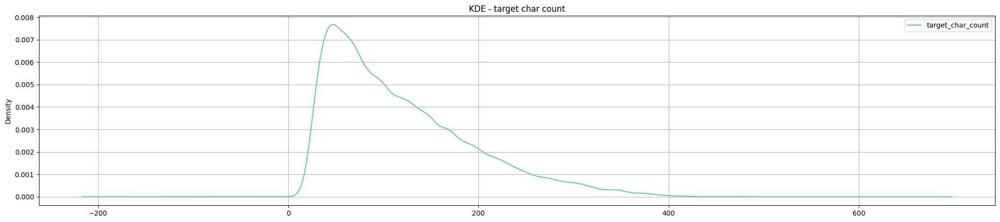

In [ ]:
plot_univariate(df,'target_char_count')

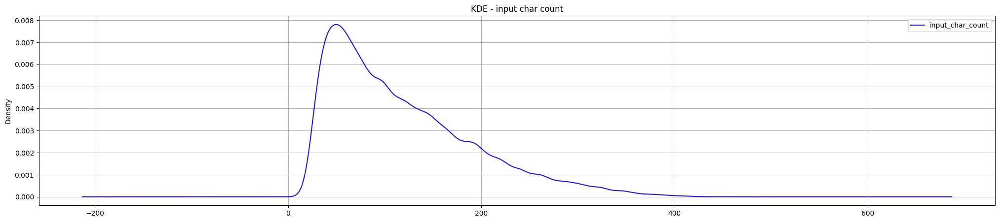

In [ ]:
plot_univariate(df,'input_char_count')

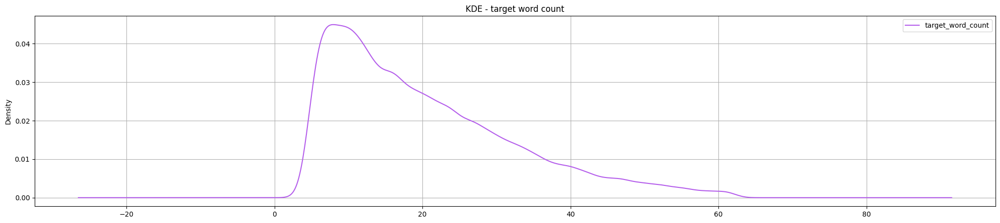

In [ ]:
plot_univariate(df,'target_word_count')

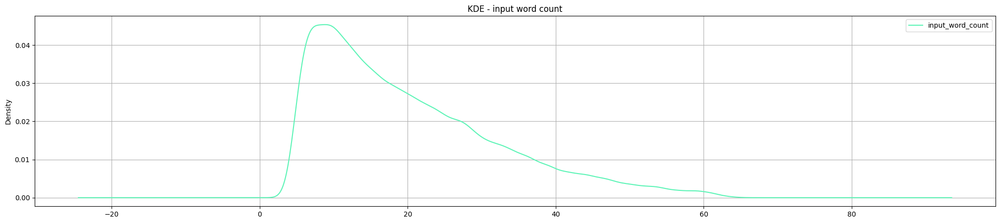

In [ ]:
plot_univariate(df,'input_word_count')

In [ ]:
show_percentiles(df,'target_char_count',(0,101),10)

,0,10,20,30,40,50,60,70,80,90,100
target_char_count,12.0,39.0,52.0,66.0,81.0,100.0,122.0,147.0,178.0,227.0,469.0


In [ ]:
show_percentiles(df,'input_char_count',(0,101),10)

,0,10,20,30,40,50,60,70,80,90,100
input_char_count,12.0,40.0,52.0,66.0,81.0,100.0,121.0,146.0,178.0,225.0,462.0


In [ ]:
show_percentiles(df,'target_word_count',(0,101),10)

,0,10,20,30,40,50,60,70,80,90,100
target_word_count,3.0,7.0,9.0,11.0,14.0,17.0,21.0,25.0,30.0,38.0,62.0


In [ ]:
show_percentiles(df,'input_word_count',(0,101),10)

,0,10,20,30,40,50,60,70,80,90,100
input_word_count,5.0,7.0,9.0,12.0,14.0,17.0,21.0,25.0,30.0,38.0,64.0


In [ ]:
def plot_histogram(df, feature_name):
    hist_bins = list(range(df[feature_name].min(), df[feature_name].max()+15,15))
    random_color = (random.random(), random.random(), random.random())
    sns.displot(list(df[feature_name].values), bins=hist_bins, kde=True, color=random_color)
    plt.grid()
    plt.title(f'Distribution of {feature_name.replace("_"," ")}')
    plt.xlabel("Bins (length)")
    plt.show()


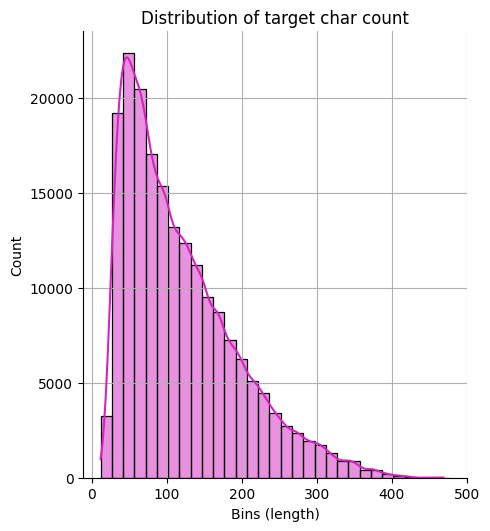

In [ ]:
plot_histogram(df, 'target_char_count')

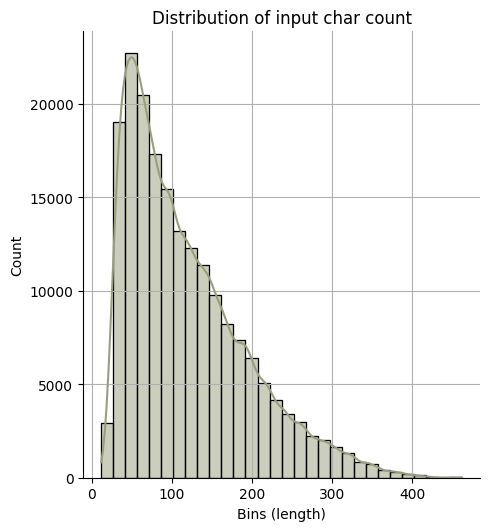

In [ ]:
plot_histogram(df, 'input_char_count')

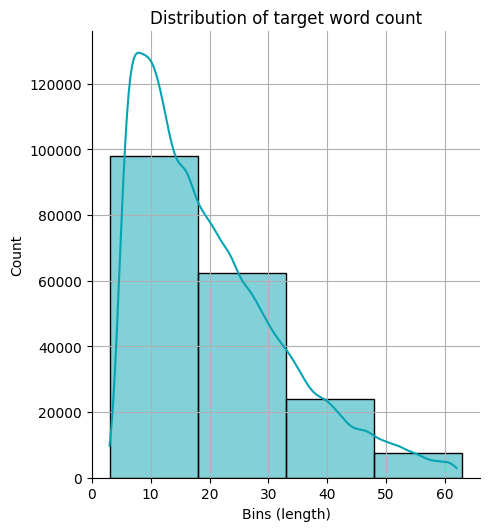

In [ ]:
plot_histogram(df, 'target_word_count')

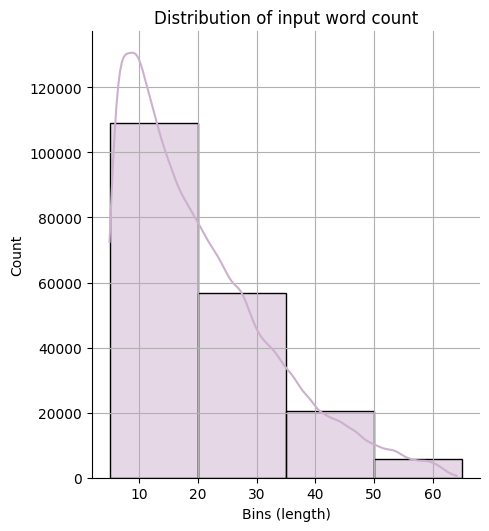

In [ ]:
plot_histogram(df, 'input_word_count')

In [ ]:
def plot_cdf(df, feature_name):
    sns.displot(df[feature_name].values, kind='ecdf')
    plt.xlabel("Length")
    plt.title(f'Cumulative distribution on {feature_name.replace("_"," ")}')
    plt.grid()
    plt.show()

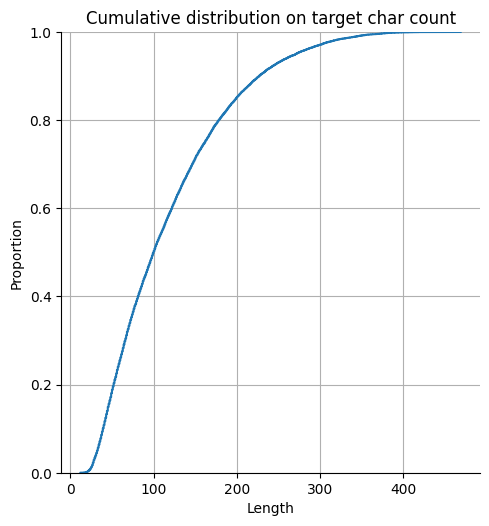

In [ ]:
plot_cdf(df, 'target_char_count')

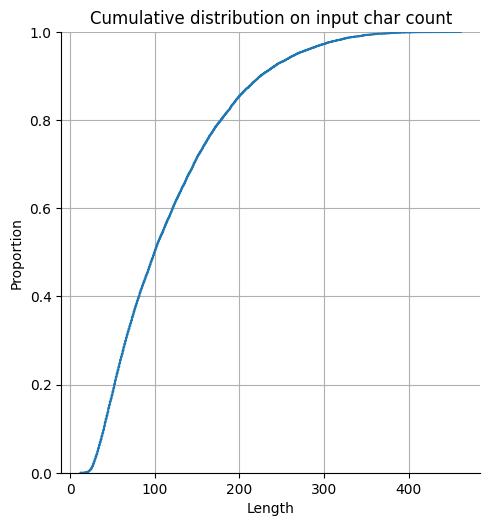

In [ ]:
plot_cdf(df, 'input_char_count')

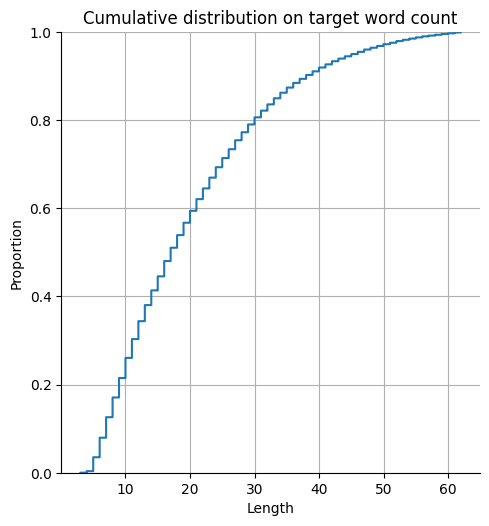

In [ ]:
plot_cdf(df, 'target_word_count')

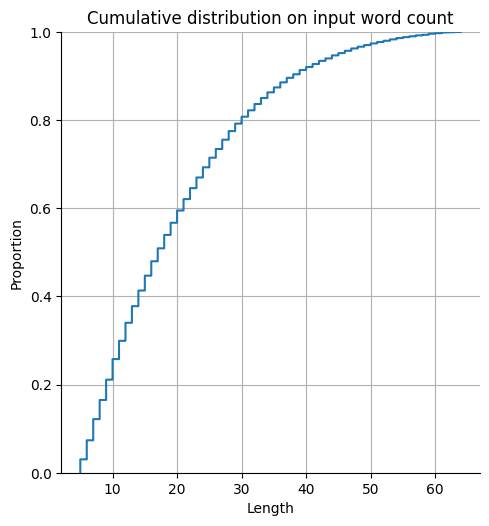

In [ ]:
plot_cdf(df, 'input_word_count')

In [ ]:
def plot_bivariate_kde(df, feature1, feature2):
    random_color1 = (random.random(), random.random(), random.random())
    random_color2 = (random.random(), random.random(), random.random())
    sns.kdeplot(df[feature1], label=f'{feature1.replace("_"," ")}', color=random_color1)
    sns.kdeplot(df[feature2], label=f'{feature2.replace("_"," ")}', color=random_color2)
    plt.grid()
    plt.legend()
    plt.xlabel("Length")
    plt.plot()

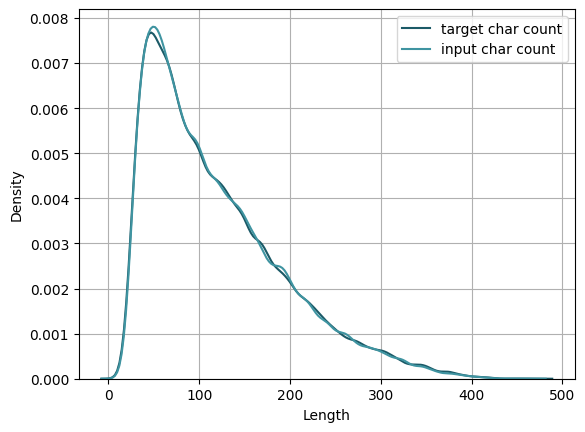

In [ ]:
plot_bivariate_kde(df, 'target_char_count', 'input_char_count')

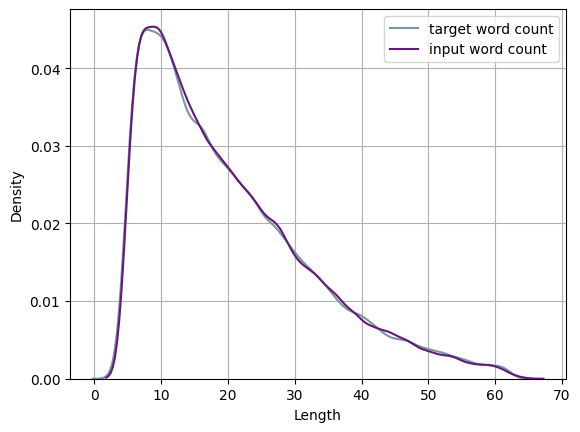

In [ ]:
plot_bivariate_kde(df, 'target_word_count', 'input_word_count')

In [ ]:
cv_input = CountVectorizer()
cv_input.fit(df['input'].astype(str).tolist())

cv_target = CountVectorizer()
cv_target.fit(df['target'].astype(str).tolist())

CountVectorizer()

In [ ]:
print('Input vocab size = ', len(cv_input.get_feature_names_out()))
print('Target vocab size = ', len(cv_target.get_feature_names_out()))

Input vocab size =  45709
Target vocab size =  39150


In [ ]:
stop=set(stopwords.words('english'))

In [ ]:
def plot_top_stopwords(text, n_top=10, title=None):
    new = text.str.split()
    new = new.values.tolist()
    corpus=[word for i in new for word in i]

    stopword_dict=defaultdict(int)
    for word in corpus:
        if word in stop:
            stopword_dict[word]+=1

    df = pd.DataFrame()
    df['word'] = stopword_dict.keys()
    df['frequency'] = stopword_dict.values()
    df['percentage'] = df['frequency']*100/df['frequency'].sum()
    df = df.sort_values('frequency',ascending=False)
    df = df.iloc[:n_top]
    fig, ax = plt.subplots(figsize=(25,n_top/2))
    ax = sns.barplot(x = "frequency", y = "word", data=df, palette="mako", orient='h')
    for i,p in enumerate(ax.patches):
        width = p.get_width()    # get bar length
        ax.text(width + 1,       # set the text at 1 unit right of the bar
                p.get_y() + p.get_height() / 2, # get Y coordinate + X coordinate / 2
                ' {:1.0f}'.format(width)+' ('+str(round(df['percentage'].iloc[i],2))+'%)', # set variable to display, 2 decimals
                ha = 'left',   # horizontal alignment
                va = 'center')  # vertical alignment
    ax.set_xlim(xmin=0.0, xmax=round(max(df['frequency']),-4)*1.1)
    if title:
        plt.title(title)
    plt.show()

<ipython-input-53-668cfffdd59f>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x = "frequency", y = "word", data=df, palette="mako", orient='h')


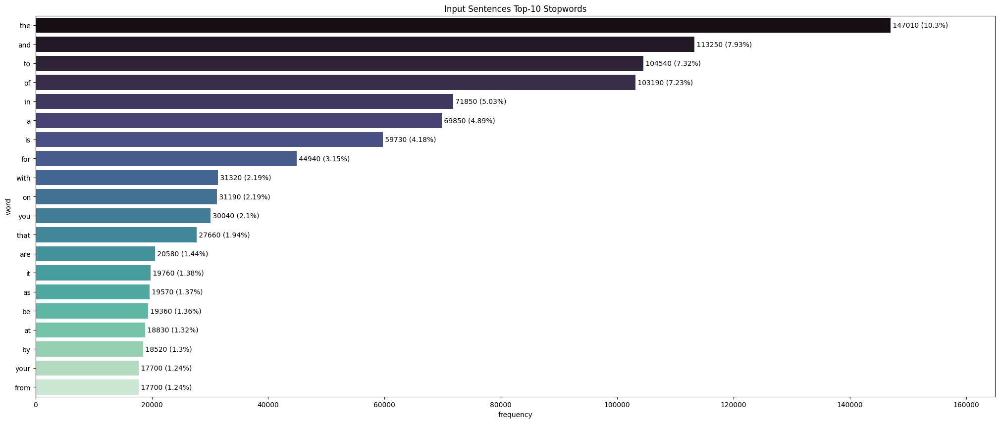

In [ ]:
plot_top_stopwords(df['input'].astype(str), n_top = 20, title='Input Sentences Top-10 Stopwords')

<ipython-input-53-668cfffdd59f>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x = "frequency", y = "word", data=df, palette="mako", orient='h')


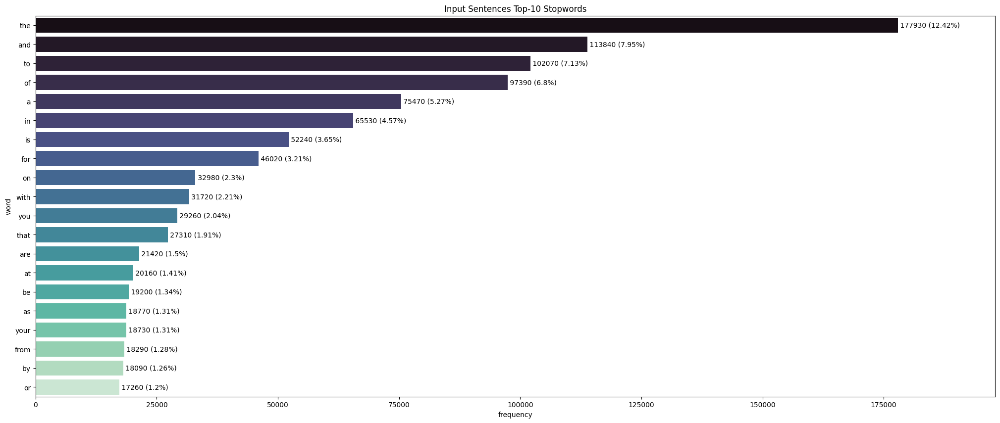

In [ ]:
plot_top_stopwords(df['target'].astype(str), n_top = 20, title='Input Sentences Top-10 Stopwords')

In [ ]:
def get_ngram_freq(text, n=2):
    new= text.str.split()
    new=new.values.tolist()
    corpus=[word for i in new for word in i]
    vec = CountVectorizer(ngram_range=(n, n)).fit(text)
    bag_of_words = vec.transform(text)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:10]


def plot_top_ngrams(words_freq, n_top=10, title=None):
    df = pd.DataFrame()
    df['gram'] = [i[0] for i in words_freq]
    df['frequency'] = [i[1] for i in words_freq]
    df['percentage'] = df['frequency']*100/df['frequency'].sum()
    df = df.sort_values('frequency',ascending=False)
    df = df.iloc[:n_top]
    fig, ax = plt.subplots(figsize=(25,n_top/2))
    ax = sns.barplot(x =df["frequency"], y = df["gram"], palette="mako", orient='h')
    for i,p in enumerate(ax.patches):
        width = p.get_width()    # get bar length
        ax.text(width + 1,       # set the text at 1 unit right of the bar
                p.get_y() + p.get_height() / 2, # get Y coordinate + X coordinate / 2
                ' {:1.0f}'.format(width)+' ('+str(round(df['percentage'].iloc[i],2))+'%)', # set variable to display, 2 decimals
                ha = 'left',   # horizontal alignment
                va = 'center')  # vertical alignment
    ax.set_xlim(xmin=0.0, xmax=round(max(df['frequency']),-4)*1.1)
    if title:
        plt.title(title)
    plt.show()

In [ ]:
input_bigrams = get_ngram_freq(df['input'].astype(str), 2)

<ipython-input-70-1482a157bd40>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x =df["frequency"], y = df["gram"], palette="mako", orient='h')


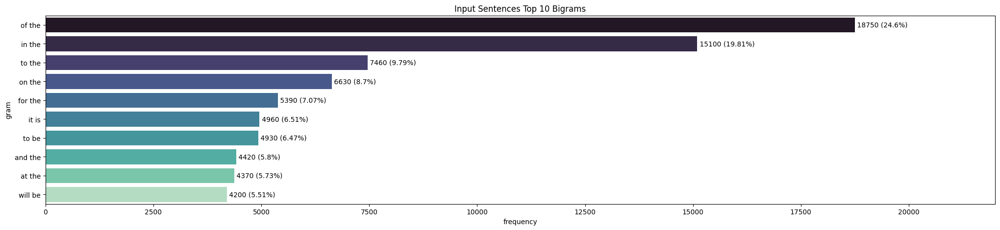

In [ ]:
plot_top_ngrams(input_bigrams, 10, title='Input Sentences Top 10 Bigrams')

In [ ]:
target_bigrams = get_ngram_freq(df['target'].astype(str), 2)

<ipython-input-70-1482a157bd40>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x =df["frequency"], y = df["gram"], palette="mako", orient='h')


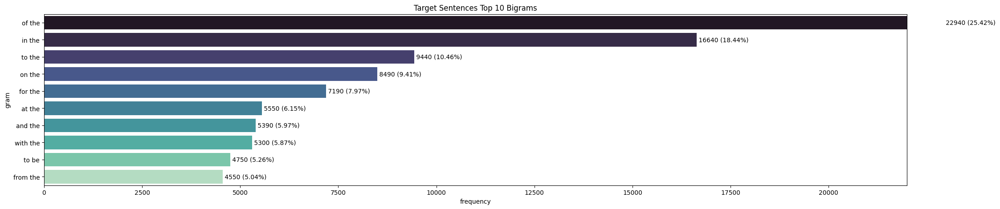

In [ ]:
plot_top_ngrams(target_bigrams, 10, title='Target Sentences Top 10 Bigrams')

In [ ]:
def generate_wordcloud(text):
    corpus=[]
    stem=PorterStemmer()
    lem=WordNetLemmatizer()
    for news in tqdm(text):
        words=[w for w in word_tokenize(news) if (w not in stop)]

        words=[lem.lemmatize(w) for w in words if len(w)>2]

        corpus.append(words)
    return corpus

In [ ]:
def plot_wordcloud(corpus,title=None):
    wordcloud = WordCloud(background_color='black',stopwords=set(STOPWORDS),
                          max_words=100,max_font_size=30,scale=3,random_state=1)
    wordcloud=wordcloud.generate(str(corpus))
    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    plt.imshow(wordcloud)
    if title:
        plt.title(title)
    plt.show()

In [ ]:
correct_sen_wordcloud = generate_wordcloud(df['input'].astype(str))

100%|██████████| 192090/192090 [01:30<00:00, 2120.72it/s]


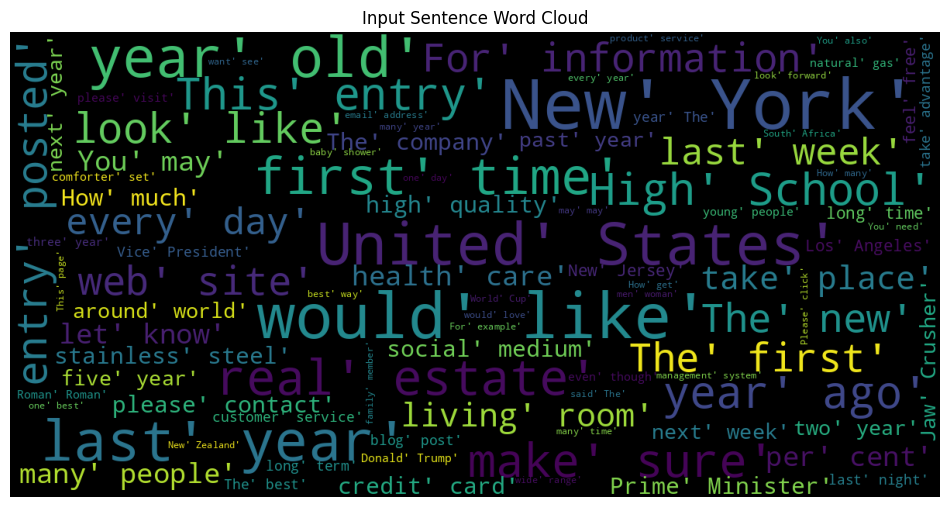

In [ ]:
plot_wordcloud(correct_sen_wordcloud,'Input Sentence Word Cloud')

In [ ]:
incorrect_sen_corpus = generate_wordcloud(df['target'].astype(str))

100%|██████████| 192090/192090 [01:01<00:00, 3141.28it/s]


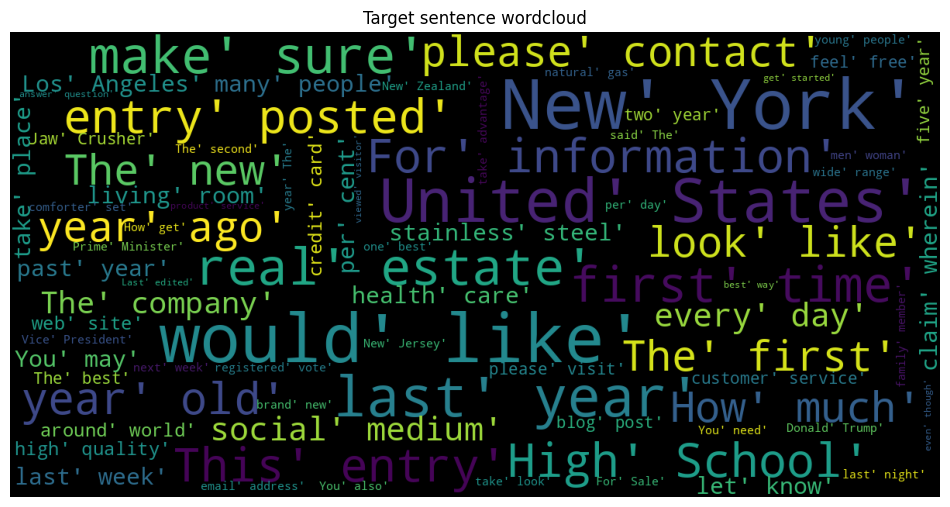

In [ ]:
plot_wordcloud(incorrect_sen_corpus,'Target sentence wordcloud')

#4.Data Preparation for Model

In [6]:
MAX_SEQ_LEN = 20

In [ ]:
train, test = train_test_split(df, test_size=0.05)
train, validation = train_test_split(train, test_size = 0.1)

In [ ]:
table = PrettyTable(['SR.No.','Description','Size'])

table.add_row([1, 'Train', train.shape])
table.add_row([2, 'Validation',validation.shape])
table.add_row([3, 'Test', test.shape])

print(table)

+--------+-------------+-------------+
| SR.No. | Description |     Size    |
+--------+-------------+-------------+
|   1    |    Train    | (164236, 2) |
|   2    |  Validation |  (18249, 2) |
|   3    |     Test    |  (9605, 2)  |
+--------+-------------+-------------+


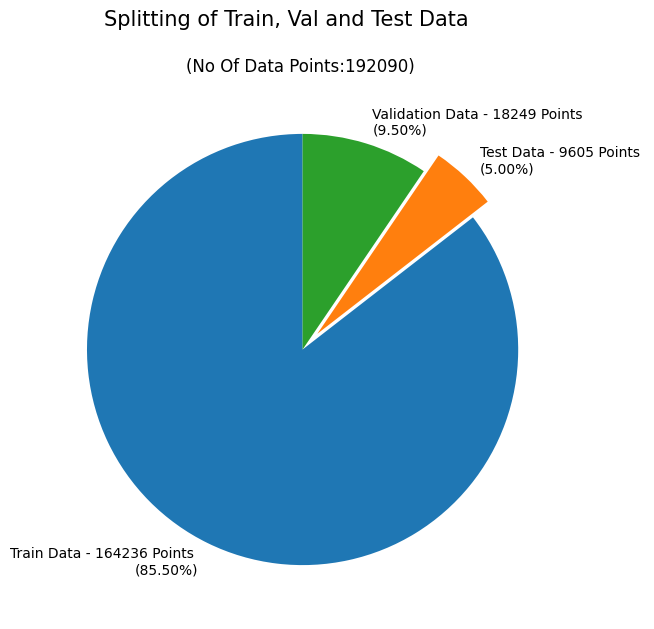

In [ ]:
fig,ax = plt.subplots(figsize =(10, 7))
labels_split = ['Train', 'Test','Validation']
sizes_split = [len(train),len(test),len(validation)]
pcts_split = [f'{l} Data - {s} Points \n({s*100/sum(sizes_split):.2f}%)' for s,l in zip(sizes_split, labels_split)]
ax.pie(sizes_split, labels = pcts_split, startangle = 90,
       explode=(0,0.1,0), textprops = {"fontsize":10} )

plt.suptitle(f'Splitting of Train, Val and Test Data ', fontsize = 15)
plt.title(f'(No Of Data Points:{sum(sizes_split)}) ', fontsize = 12)
plt.show()

In [ ]:
train.to_csv(os.path.join(CSV_DIR, CSV_C4, f'{MAX_SEQ_LEN}_train.csv'), index=False)
validation.to_csv(os.path.join(CSV_DIR, CSV_C4, f'{MAX_SEQ_LEN}_validation.csv'), index=False)
test.to_csv(os.path.join(CSV_DIR, CSV_C4, f'{MAX_SEQ_LEN}_test.csv'), index=False)

In [32]:
#load
train = pd.read_csv(os.path.join(CSV_DIR, CSV_C4, f'{MAX_SEQ_LEN}_train.csv'))
validation = pd.read_csv(os.path.join(CSV_DIR, CSV_C4, f'{MAX_SEQ_LEN}_validation.csv'))
test = pd.read_csv(os.path.join(CSV_DIR, CSV_C4, f'{MAX_SEQ_LEN}_test.csv'))

In [37]:
test.head()

,input,target,target_char_count,input_char_count,target_word_count,input_word_count
0,Having limited all of service that service pro...,Limited visibility features of church services...,141,145,22,24
1,Promo Code Get up to off of Golf Outings Sport...,Promo Code Get up to off Golf Outings Sports T...,145,148,23,24
2,Our physician advisors have served on admissio...,Our physician advisors have served on admissio...,154,170,21,24
3,These universally valuale skills and traits ar...,These universally valuable skills and traits a...,186,202,25,28
4,This is how to delet and clear Facebook search...,This is how to delete and clear Facebook searc...,153,153,27,26


In [40]:
df_test = test[test['input_word_count']<20].reset_index(drop=True)
df_test = test[test['target_word_count']<20].reset_index(drop=True)

df_test = test[test['input_word_count']>5].reset_index(drop=True)
df_test = test[test['target_word_count']>5].reset_index(drop=True)

In [ ]:
START_TOKEN = '<start>'
END_TOKEN = '<end>'

In [ ]:
train['decoder_inp'] = START_TOKEN + ' ' + train['target'].astype(str)
train['decoder_out'] = train['target'].astype(str) +' ' + END_TOKEN

validation['decoder_inp'] = START_TOKEN + ' ' + validation['target'].astype(str)
validation['decoder_out'] = validation['target'].astype(str) + ' ' + END_TOKEN

test['decoder_inp'] = START_TOKEN + ' ' + test['target'].astype(str)
test['decoder_out'] = test['target'].astype(str) +' ' + END_TOKEN

In [ ]:
tokenizer_encoder = Tokenizer(filters='', oov_token='<oov>', lower=False)
tokenizer_encoder.fit_on_texts(train['input'].values.tolist())

tokenizer_decoder = Tokenizer(filters='', oov_token='<oov>', lower=False)
tokenizer_decoder.fit_on_texts(train['decoder_inp'].values.tolist())

In [ ]:
print(f'Vocab size of Input is: {len(tokenizer_encoder.word_index)}')
print(f'Vocab size of Target is: {len(tokenizer_decoder.word_index)}')

Vocab size of Input is: 54661
Vocab size of Target is: 47951


In [ ]:
tokenizer_decoder.word_index[END_TOKEN] = len(tokenizer_decoder.word_index) + 1

In [ ]:
tokenizer_decoder.word_index[START_TOKEN], tokenizer_decoder.word_index.get(END_TOKEN, None)

(2, 47952)

In [ ]:
#save
with open(f'./checkpoints/c4_200m/tokenizer_encoder_{MAX_SEQ_LEN}_2.0.pickle', 'wb') as fp:
  pickle.dump(tokenizer_encoder, fp)

with open(f'./checkpoints/c4_200m/tokenizer_decoder_{MAX_SEQ_LEN}_2.0.pickle', 'wb') as fp:
  pickle.dump(tokenizer_decoder, fp)

In [ ]:
#training dataset
train_encoder_inp = tokenizer_encoder.texts_to_sequences(train['input'].values.tolist())
train_decoder_inp = tokenizer_decoder.texts_to_sequences(train['decoder_inp'].values.tolist())
train_decoder_out = tokenizer_decoder.texts_to_sequences(train['decoder_out'].values.tolist())

train_encoder_inp = pad_sequences(train_encoder_inp, maxlen=MAX_SEQ_LEN, dtype='int32', padding='post', truncating='post', value=0)
train_decoder_inp = pad_sequences(train_decoder_inp, maxlen=MAX_SEQ_LEN+1, dtype='int32', padding='post', truncating='post', value=0)
train_decoder_out = pad_sequences(train_decoder_out, maxlen=MAX_SEQ_LEN+1, dtype='int32', padding='post', truncating='post', value=0)


#validation dataset
validation_encoder_inp = tokenizer_encoder.texts_to_sequences(validation['input'].values.tolist())
validation_decoder_inp = tokenizer_decoder.texts_to_sequences(validation['decoder_inp'].values.tolist())
validation_decoder_out = tokenizer_decoder.texts_to_sequences(validation['decoder_out'].values.tolist())

validation_encoder_inp = pad_sequences(validation_encoder_inp, maxlen=MAX_SEQ_LEN, dtype='int32', padding='post', truncating='post', value=0)
validation_decoder_inp = pad_sequences(validation_decoder_inp, maxlen=MAX_SEQ_LEN+1, dtype='int32', padding='post', truncating='post', value=0)
validation_decoder_out = pad_sequences(validation_decoder_out, maxlen=MAX_SEQ_LEN+1, dtype='int32', padding='post', truncating='post', value=0)

#test dataset
test_encoder_inp = tokenizer_encoder.texts_to_sequences(test['input'].values.tolist())
test_decoder_inp = tokenizer_decoder.texts_to_sequences(test['decoder_inp'].values.tolist())
test_decoder_out = tokenizer_decoder.texts_to_sequences(test['decoder_out'].values.tolist())

test_encoder_inp = pad_sequences(test_encoder_inp, maxlen=MAX_SEQ_LEN, dtype='int32', padding='post', truncating='post', value=0)
test_decoder_inp = pad_sequences(test_decoder_inp, maxlen=MAX_SEQ_LEN+1, dtype='int32', padding='post', truncating='post', value=0)
test_decoder_out = pad_sequences(test_decoder_out, maxlen=MAX_SEQ_LEN+1, dtype='int32', padding='post', truncating='post', value=0)

In [ ]:
#save
np.save(f'./Data/numpy_array/c4_train_encoder_inp_{MAX_SEQ_LEN}_2.0.npy', train_encoder_inp)
np.save(f'./Data/numpy_array/c4_train_decoder_inp_{MAX_SEQ_LEN}_2.0.npy', train_decoder_inp)
np.save(f'./Data/numpy_array/c4_train_decoder_out_{MAX_SEQ_LEN}_2.0.npy', train_decoder_out)

np.save(f'./Data/numpy_array/c4_validation_encoder_inp_{MAX_SEQ_LEN}_2.0.npy', validation_encoder_inp)
np.save(f'./Data/numpy_array/c4_validation_decoder_inp_{MAX_SEQ_LEN}_2.0.npy', validation_decoder_inp)
np.save(f'./Data/numpy_array/c4_validation_decoder_out_{MAX_SEQ_LEN}_2.0.npy', validation_decoder_out)

np.save(f'./Data/numpy_array/c4_test_encoder_inp_{MAX_SEQ_LEN}_2.0.npy', test_encoder_inp)
np.save(f'./Data/numpy_array/c4_test_decoder_inp_{MAX_SEQ_LEN}_2.0.npy', test_decoder_inp)
np.save(f'./Data/numpy_array/c4_test_decoder_out_{MAX_SEQ_LEN}_2.0.npy', test_decoder_out)

In [ ]:
# number of unique words in encoder dictionary.
print("Number of unique words in encoder dictionary=", len(tokenizer_encoder.word_index))
print("Dictionary is = ", tokenizer_encoder.word_index)

Number of unique words in encoder dictionary= 54661
Dictionary is =  {'<oov>': 1, 'the': 2, 'and': 3, 'to': 4, 'of': 5, 'in': 6, 'a': 7, 'is': 8, 'for': 9, 'with': 10, 'on': 11, 'you': 12, 'that': 13, 'The': 14, 'are': 15, 'I': 16, 'it': 17, 'as': 18, 'be': 19, 'at': 20, 'by': 21, 'from': 22, 'your': 23, 'or': 24, 'this': 25, 'have': 26, 'will': 27, 'not': 28, 'was': 29, 'can': 30, 'an': 31, 'has': 32, 'more': 33, 'all': 34, 'which': 35, 'we': 36, 'our': 37, 'about': 38, 'but': 39, 'one': 40, 'their': 41, 'do': 42, 'they': 43, 'out': 44, 'up': 45, 'my': 46, 'his': 47, 'new': 48, 'who': 49, 'also': 50, 'A': 51, 'time': 52, 'if': 53, 'he': 54, 'so': 55, 'its': 56, 'like': 57, 'In': 58, 'other': 59, 'been': 60, 'This': 61, 'would': 62, 'any': 63, 'get': 64, 'when': 65, 'there': 66, 'what': 67, 'had': 68, 'were': 69, 'some': 70, 'how': 71, 'We': 72, 'over': 73, 'make': 74, 'just': 75, 'use': 76, 'only': 77, 'said': 78, 'first': 79, 'them': 80, 'no': 81, 'If': 82, 'than': 83, 'into': 84, 'w

In [ ]:
# number of unique words in decoder dictionary.
print("Number of unique words in decoder dictionary=", len(tokenizer_decoder.word_index))
print("Dictionary is = ", tokenizer_decoder.word_index)

Number of unique words in decoder dictionary= 47952
Dictionary is =  {'<oov>': 1, '<start>': 2, 'the': 3, 'and': 4, 'to': 5, 'of': 6, 'a': 7, 'in': 8, 'is': 9, 'for': 10, 'on': 11, 'with': 12, 'you': 13, 'that': 14, 'The': 15, 'are': 16, 'at': 17, 'I': 18, 'be': 19, 'as': 20, 'your': 21, 'from': 22, 'by': 23, 'or': 24, 'it': 25, 'have': 26, 'this': 27, 'will': 28, 'was': 29, 'not': 30, 'an': 31, 'can': 32, 'has': 33, 'all': 34, 'our': 35, 'more': 36, 'we': 37, 'their': 38, 'but': 39, 'which': 40, 'about': 41, 'one': 42, 'out': 43, 'they': 44, 'his': 45, 'A': 46, 'its': 47, 'up': 48, 'do': 49, 'new': 50, 'also': 51, 'my': 52, 'This': 53, 'been': 54, 'who': 55, 'if': 56, 'other': 57, 'time': 58, 'so': 59, 'he': 60, 'any': 61, 'In': 62, 'would': 63, 'like': 64, 'We': 65, 'when': 66, 'get': 67, 'into': 68, 'some': 69, 'over': 70, 'If': 71, 'said': 72, 'how': 73, 'what': 74, 'just': 75, 'there': 76, 'were': 77, 'use': 78, 'You': 79, 'make': 80, 'had': 81, 'first': 82, 'than': 83, 'no': 84, 

In [ ]:
# def embedding_vector(filepath, word_index, embedding_dim):
#     vocab_size = len(word_index) + 1

#     # Adding again 1 because of reserved 0 index
#     embedding_matrix_vocab = np.zeros((vocab_size, embedding_dim))

#     with open(filepath, encoding="utf8") as f:
#         for line in tqdm(f):
#             values = line.rstrip().split(' ')
#             word = values[0]
#             if word in word_index:
#                 idx = word_index[word]
#                 embedding_matrix_vocab[idx] = np.array(list(values[1:]), dtype=np.float32)[:embedding_dim]

#     return embedding_matrix_vocab

In [ ]:
# # matrix for vocab: word_index
# embedding_dim = 300
# encoder_emb_matrix_glove = embedding_vector('./glove.840B.300d.txt', tokenizer_encoder.word_index, embedding_dim)

# print("Dense vector for first word is => ", encoder_emb_matrix_glove[1])

In [ ]:
# # matrix for vocab: word_index
# embedding_dim = 300
# decoder_emb_matrix_glove = embedding_vector('./glove.840B.300d.txt', tokenizer_decoder.word_index, embedding_dim)

# print("Dense vector for first word is => ", encoder_emb_matrix_glove[1])

In [ ]:
# np.save(f'./Data/numpy_array/c4_encoder_embeddings_glove_{MAX_SEQ_LEN}.npy', encoder_emb_matrix_glove)
# np.save(f'./Data/numpy_array/c4_decoder_embeddings_glove_{MAX_SEQ_LEN}.npy', decoder_emb_matrix_glove)

##4.1. Model Data Loading

In [10]:
#train
train_encoder_inp = np.load(f'./Data/numpy_array/c4_train_encoder_inp_{MAX_SEQ_LEN}.npy')
train_decoder_inp = np.load(f'./Data/numpy_array/c4_train_decoder_inp_{MAX_SEQ_LEN}.npy')
train_decoder_out = np.load(f'./Data/numpy_array/c4_train_decoder_out_{MAX_SEQ_LEN}.npy')

#validation
validation_encoder_inp = np.load(f'./Data/numpy_array/c4_validation_encoder_inp_{MAX_SEQ_LEN}.npy')
validation_decoder_inp = np.load(f'./Data/numpy_array/c4_validation_decoder_inp_{MAX_SEQ_LEN}.npy')
validation_decoder_out = np.load(f'./Data/numpy_array/c4_validation_decoder_out_{MAX_SEQ_LEN}.npy')

In [11]:
encoder_embeddings = np.load(f'./Data/numpy_array/c4_encoder_embeddings_glove_{MAX_SEQ_LEN}.npy')
decoder_embeddings = np.load(f'./Data/numpy_array/c4_decoder_embeddings_glove_{MAX_SEQ_LEN}.npy')

In [12]:
print("Embedding Shapes : ")
print("Encoder Embedding: ",encoder_embeddings.shape)
print("Decoder Embedding: ",decoder_embeddings.shape)

table = PrettyTable(['SR.No.','Description','Encode Shape', 'Decoder Input Shape', 'Decoder Output Shape'])

table.add_row([1, 'Train', train_encoder_inp.shape, train_decoder_inp.shape, train_decoder_out.shape])
table.add_row([2, 'Validation',validation_encoder_inp.shape, validation_decoder_inp.shape, validation_decoder_out.shape])

print(table)

Embedding Shapes : 
Encoder Embedding:  (54661, 300)
Decoder Embedding:  (47952, 300)
+--------+-------------+--------------+---------------------+----------------------+
| SR.No. | Description | Encode Shape | Decoder Input Shape | Decoder Output Shape |
+--------+-------------+--------------+---------------------+----------------------+
|   1    |    Train    | (164236, 20) |     (164236, 21)    |     (164236, 21)     |
|   2    |  Validation | (18249, 20)  |     (18249, 21)     |     (18249, 21)      |
+--------+-------------+--------------+---------------------+----------------------+


#5.Model

##5.1.Encoder

In [13]:
class Encoder(tensorflow.keras.Model):

  def __init__(self, vocab_size, output_dim, input_length, lstm_units, batch_size, embedding_matrix=None, em_trainable=False):
    super().__init__()
    self.lstm_units = lstm_units
    self.batch_size = batch_size
    self.en_hidden_state = 0
    self.en_cell_state = 0
    self.en_output = 0

    #define layers
    if embedding_matrix is None:
      self.embedding = Embedding(input_dim=vocab_size, output_dim=output_dim, input_length=input_length, mask_zero=True, name="encoder_embedding")
    else:
      self.embedding = Embedding(input_dim=vocab_size, output_dim=output_dim, input_length=input_length, mask_zero=True,\
                                 weights=[embedding_matrix], trainable=em_trainable, name='encoder_embedding')

    self.encoder = LSTM(units=self.lstm_units,return_state=True, return_sequences=True, name='encoder')
    # self.encoder = Bidirectional(LSTM(units=self.lstm_units,return_state=True, return_sequences=True, name='encoder'))

  def call(self, input_sequences, states):

    em_output = self.embedding(input_sequences)
    self.en_output, self.en_hidden_state, self.en_cell_state = self.encoder(em_output, initial_state=states)

    # self.en_output, forward_h, forawrd_c, backward_h, backward_c = self.encoder(em_output, initial_state=states)
    # self.en_hidden_state = tensorflow.concat([forward_h, backward_h], axis=-1)
    # self.en_cell_state = tensorflow.concat([forward_c, backward_c], axis=-1)

    return self.en_output, self.en_hidden_state, self.en_cell_state

  def initialize_states(self):

    self.en_hidden_state = tensorflow.zeros(shape=(self.batch_size, self.lstm_units))
    self.en_cell_state = tensorflow.zeros(shape=(self.batch_size, self.lstm_units))

    return [self.en_hidden_state, self.en_cell_state]

##5.2.Decoder

In [14]:
class Decoder(tensorflow.keras.Model):
  def __init__(self, vocab_size, output_dim, input_length, dec_units, batch_sz, embedding_matrix=None, em_trainable=False, attention_type='luong'):
    super().__init__()
    self.batch_sz = batch_sz
    self.dec_units = dec_units
    self.attention_type = attention_type
    self.input_length = input_length

    # Define Embedding Layer
    if embedding_matrix is None:
      self.embedding = Embedding(input_dim=vocab_size, output_dim=output_dim, input_length=input_length, name='decoder_embedding')
    else:
      self.embedding = Embedding(input_dim=vocab_size, output_dim=output_dim, input_length=input_length, weights=[embedding_matrix], trainable=em_trainable)

    #Final Dense layer on which softmax will be applied
    self.fc = Dense(vocab_size+1)

    # Define the fundamental cell for decoder recurrent structure
    self.decoder_rnn_cell = LSTMCell(self.dec_units)

    # Sampler
    self.sampler = tfa.seq2seq.sampler.TrainingSampler()

    # Create attention mechanism with memory = None
    self.attention_mechanism = self.build_attention_mechanism(self.dec_units, None, self.batch_sz*[self.input_length], self.attention_type)

    # Wrap attention mechanism with the fundamental rnn cell of decoder
    self.rnn_cell = self.build_rnn_cell(batch_sz)

    # Define the decoder with respect to fundamental rnn cell
    self.decoder = tfa.seq2seq.BasicDecoder(self.rnn_cell, sampler=self.sampler, output_layer=self.fc)


  def build_rnn_cell(self, batch_sz):
    rnn_cell = tfa.seq2seq.AttentionWrapper(self.decoder_rnn_cell,
                                  self.attention_mechanism, attention_layer_size=self.dec_units)
    return rnn_cell

  def build_attention_mechanism(self, dec_units, memory, memory_sequence_length, attention_type='luong'):
    # ------------- #
    # typ: Which sort of attention (Bahdanau, Luong)
    # dec_units: final dimension of attention outputs
    # memory: encoder hidden states of shape (batch_size, max_length_input, enc_units)
    # memory_sequence_length: 1d array of shape (batch_size) with every element set to max_length_input (for masking purpose)

    if(attention_type=='bahdanau'):
      return tfa.seq2seq.BahdanauAttention(units=dec_units, memory=memory, memory_sequence_length=memory_sequence_length)
    else:
      return tfa.seq2seq.LuongAttention(units=dec_units, memory=memory, memory_sequence_length=memory_sequence_length)

  def build_initial_state(self, batch_sz, encoder_state, Dtype):
    decoder_initial_state = self.rnn_cell.get_initial_state(batch_size=batch_sz, dtype=Dtype)
    decoder_initial_state = decoder_initial_state.clone(cell_state=encoder_state)
    return decoder_initial_state


  def call(self, inputs, initial_state):
    x = self.embedding(inputs)
    outputs, _, _ = self.decoder(x, initial_state=initial_state, sequence_length=self.batch_sz*[self.input_length])
    return outputs

##5.3.Encoder Decoder

In [15]:
class Encoder_Decoder_Attention(tensorflow.keras.Model):

  def __init__(self, en_vocab_size, en_out_dim, en_input_length, en_lstm, de_vocab_size, de_out_dim, de_input_length, de_lstm, batch_size,\
               attention='loung', en_embeddings=None, en_emb_trainable=False, de_embeddings=None, de_emb_trainable=False):

    super().__init__()
    #obj to encoder
    self.batch_size = batch_size
    self.encoder = Encoder(en_vocab_size, en_out_dim, en_input_length, en_lstm, batch_size, en_embeddings, en_emb_trainable)
    self.decoder = Decoder(de_vocab_size, de_out_dim, de_input_length, de_lstm, batch_size, de_embeddings, de_emb_trainable ,attention)


  def call(self, data):

    input_seq, target_seq = data[0], data[1]

    #get encoder initial states
    enc_states = self.encoder.initialize_states()

    #encod input
    enc_output, en_hidden_state, en_cell_state = self.encoder(input_seq, enc_states)

    #set attention with encoder output
    self.decoder.attention_mechanism.setup_memory(enc_output)

    #get initial ststes for decoder
    de_initial_state = self.decoder.build_initial_state(self.batch_size, [en_hidden_state, en_cell_state], tensorflow.float32)

    #get predictions from decoder
    pred = self.decoder(target_seq, de_initial_state)

    #return the final output
    return pred.rnn_output

##5.4.Optimizer and Loss Function

In [16]:
optimizer = tensorflow.keras.optimizers.legacy.Adam()

loss_object = tensorflow.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')
def loss_function(real, pred):
  mask = tensorflow.math.logical_not(tensorflow.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tensorflow.cast(mask, dtype=loss_.dtype)
  loss_ *= mask

  return tensorflow.reduce_mean(loss_)

#6.Training Parameters

In [17]:
inp_vocab_size = encoder_embeddings.shape[0]
out_vocab_size = decoder_embeddings.shape[0]

emb_dim = encoder_embeddings.shape[1]

en_inp_len = MAX_SEQ_LEN
de_inp_len = MAX_SEQ_LEN+1

lstm_size=64
batch_size=512

tr_pts = (train_encoder_inp.shape[0]//batch_size) * batch_size
val_pts = (validation_encoder_inp.shape[0]//batch_size) * batch_size

tr_pts, val_pts

(163840, 17920)

#7.Model Traning

##7.1.Model-1 Embedding Layer Trainable

In [18]:
tensorflow.keras.backend.clear_session()

In [ ]:
en_de_bahdanau_trainable = Encoder_Decoder_Attention(inp_vocab_size, emb_dim, en_inp_len, lstm_size,\
                                                     out_vocab_size, emb_dim, de_inp_len, lstm_size,\
                                                     batch_size,attention='bahdanau',\
                                                     en_embeddings=encoder_embeddings, en_emb_trainable=True,
                                                     de_embeddings=decoder_embeddings, de_emb_trainable=True)

In [ ]:
en_de_bahdanau_trainable.compile(loss=loss_function, optimizer=optimizer)

es = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=5, verbose=1)
mc = ModelCheckpoint('./checkpoints/c4_200m/en_de_bahdanau_trainable/en_de_bahdanau_trainable.ckpt',verbose=0, monitor='val_loss',save_best_only=True, save_weights_only=True,mode='auto')
reducelr = ReduceLROnPlateau(monitor='val_loss', min_delta=0.01, patience=4, verbose=1)
log_dir = './Tensorboard/c4_200m/en_de_bahdanau_trainable/en_de_bahdanau_trainable'
tb = TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks = [es, mc, tb, reducelr]

In [ ]:
en_de_bahdanau_trainable.fit(x=[train_encoder_inp[:tr_pts], train_decoder_inp[:tr_pts]], y=train_decoder_out[:tr_pts],\
                             validation_data=([validation_encoder_inp[:val_pts], validation_decoder_inp[:val_pts]], validation_decoder_out[:val_pts]),\
                             batch_size=batch_size, epochs=80, callbacks=callbacks)

Epoch 1/80
320/320 [==============================] - 318s 945ms/step - loss: 5.9605 - val_loss: 5.3870 - lr: 0.0010
Epoch 2/80
320/320 [==============================] - 283s 886ms/step - loss: 4.6871 - val_loss: 3.8903 - lr: 0.0010
Epoch 3/80
320/320 [==============================] - 301s 942ms/step - loss: 3.0113 - val_loss: 2.2964 - lr: 0.0010
Epoch 4/80
320/320 [==============================] - 282s 882ms/step - loss: 1.7217 - val_loss: 1.3369 - lr: 0.0010
Epoch 5/80
320/320 [==============================] - 306s 956ms/step - loss: 1.0044 - val_loss: 0.8430 - lr: 0.0010
Epoch 6/80
320/320 [==============================] - 283s 885ms/step - loss: 0.6485 - val_loss: 0.5848 - lr: 0.0010
Epoch 7/80
320/320 [==============================] - 302s 945ms/step - loss: 0.4807 - val_loss: 0.4561 - lr: 0.0010
Epoch 8/80
320/320 [==============================] - 306s 958ms/step - loss: 0.3790 - val_loss: 0.3903 - lr: 0.0010
Epoch 9/80
320/320 [==============================] - 285s 889ms

In [ ]:
en_de_bahdanau_trainable.summary()

Model: "encoder__decoder__attention"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder (Encoder)           multiple                  16491740  
                                                                 
 decoder (Decoder)           multiple                  17628817  
                                                                 
Total params: 34120557 (130.16 MB)
Trainable params: 34120557 (130.16 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
%load_ext tensorboard
%tensorboard --logdir './Tensorboard/c4_200m/en_de_bahdanau_trainable/en_de_bahdanau_trainable'

<IPython.core.display.Javascript object>

##7.2.Model-2 Embedding Layer Non Trainable

In [ ]:
tensorflow.keras.backend.clear_session()

In [19]:
en_de_bahdanau_non_trainable = Encoder_Decoder_Attention(inp_vocab_size, emb_dim, en_inp_len, lstm_size,\
                                           out_vocab_size, emb_dim, de_inp_len, lstm_size,\
                                           batch_size,attention='bahdanau',\
                                           en_embeddings=encoder_embeddings, en_emb_trainable=False,
                                           de_embeddings=decoder_embeddings, de_emb_trainable=False)

In [20]:
en_de_bahdanau_non_trainable.compile(loss=loss_function, optimizer=optimizer)

es = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=4, verbose=1)
mc = ModelCheckpoint('./checkpoints/c4_200m/en_de_bahdanau_non_trainable/en_de_bahdanau_non_trainable.ckpt',verbose=0, monitor='val_loss',save_best_only=True, save_weights_only=True,mode='auto')
log_dir = './Tensorboard/c4_200m/en_de_bahdanau_non_trainable/en_de_bahdanau_non_trainable'
tb = TensorBoard(log_dir=log_dir, histogram_freq=1)
reducelr = ReduceLROnPlateau(monitor='val_loss', min_delta=0.01, patience=4, verbose=1)

callbacks = [es, mc, tb, reducelr]

In [21]:
en_de_bahdanau_non_trainable.fit(x=[train_encoder_inp[:tr_pts], train_decoder_inp[:tr_pts]], y=train_decoder_out[:tr_pts],\
                   validation_data=([validation_encoder_inp[:val_pts], validation_decoder_inp[:val_pts]], validation_decoder_out[:val_pts]),\
                   batch_size=batch_size, epochs=80, callbacks=callbacks)

Epoch 1/80
320/320 [==============================] - 297s 876ms/step - loss: 5.9823 - val_loss: 5.4912 - lr: 0.0010
Epoch 2/80
320/320 [==============================] - 280s 876ms/step - loss: 4.9021 - val_loss: 4.2309 - lr: 0.0010
Epoch 3/80
320/320 [==============================] - 299s 936ms/step - loss: 3.5775 - val_loss: 3.0577 - lr: 0.0010
Epoch 4/80
320/320 [==============================] - 299s 935ms/step - loss: 2.5944 - val_loss: 2.3415 - lr: 0.0010
Epoch 5/80
320/320 [==============================] - 298s 932ms/step - loss: 1.9995 - val_loss: 1.8145 - lr: 0.0010
Epoch 6/80
320/320 [==============================] - 298s 932ms/step - loss: 1.6042 - val_loss: 1.5131 - lr: 0.0010
Epoch 7/80
320/320 [==============================] - 306s 956ms/step - loss: 1.3598 - val_loss: 1.3152 - lr: 0.0010
Epoch 8/80
320/320 [==============================] - 280s 876ms/step - loss: 1.1943 - val_loss: 1.1890 - lr: 0.0010
Epoch 9/80
320/320 [==============================] - 299s 933ms

KeyboardInterrupt: 

In [23]:
en_de_bahdanau_non_trainable.summary()

Model: "encoder__decoder__attention"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder (Encoder)           multiple                  16491740  
                                                                 
 decoder (Decoder)           multiple                  17628817  
                                                                 
Total params: 34120557 (130.16 MB)
Trainable params: 3336657 (12.73 MB)
Non-trainable params: 30783900 (117.43 MB)
_________________________________________________________________


In [24]:
%load_ext tensorboard
%tensorboard --logdir './Tensorboard/c4_200m/en_de_bahdanau_non_trainable/en_de_bahdanau_non_trainable'

Output hidden; open in https://colab.research.google.com to view.

#8.Model Loading

##8.1.Model-1 Embedding Layer Trainable

In [26]:
model1 = Encoder_Decoder_Attention(inp_vocab_size, emb_dim, en_inp_len, lstm_size,\
                                   out_vocab_size, emb_dim, de_inp_len, lstm_size,\
                                   batch_size,attention='bahdanau',\
                                   en_embeddings=encoder_embeddings, en_emb_trainable=True,
                                   de_embeddings=decoder_embeddings, de_emb_trainable=True)

model1.compile(optimizer=optimizer, loss=loss_function)

model1.train_on_batch([train_encoder_inp[:batch_size], train_decoder_inp[:batch_size]], train_decoder_out[:batch_size])
model1.load_weights('./checkpoints/c4_200m/en_de_bahdanau_trainable/en_de_bahdanau_trainable.ckpt')
model1.summary()

Model: "encoder__decoder__attention_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_2 (Encoder)         multiple                  16491740  
                                                                 
 decoder_2 (Decoder)         multiple                  17628817  
                                                                 
Total params: 34120557 (130.16 MB)
Trainable params: 34120557 (130.16 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


##8.2.Model-2 Embedding Layer Non-Trainable


In [25]:
model2 = Encoder_Decoder_Attention(inp_vocab_size, emb_dim, en_inp_len, lstm_size,\
                                   out_vocab_size, emb_dim, de_inp_len, lstm_size,\
                                   batch_size,attention='bahdanau',\
                                   en_embeddings=encoder_embeddings, en_emb_trainable=False,
                                   de_embeddings=decoder_embeddings, de_emb_trainable=False)

model2.compile(optimizer=optimizer, loss=loss_function)

model2.train_on_batch([train_encoder_inp[:batch_size], train_decoder_inp[:batch_size]], train_decoder_out[:batch_size])
model2.load_weights('./checkpoints/c4_200m/en_de_bahdanau_non_trainable/en_de_bahdanau_non_trainable.ckpt')
model2.summary()

Model: "encoder__decoder__attention_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_1 (Encoder)         multiple                  16491740  
                                                                 
 decoder_1 (Decoder)         multiple                  17628817  
                                                                 
Total params: 34120557 (130.16 MB)
Trainable params: 3336657 (12.73 MB)
Non-trainable params: 30783900 (117.43 MB)
_________________________________________________________________


#9.Inference using Beam Search

In [27]:
with open (f'./checkpoints/c4_200m/tokenizer_encoder_{MAX_SEQ_LEN}.pickle', 'rb') as fp:
  tokenizer_encoder = pickle.load(fp)

with open (f'./checkpoints/c4_200m/tokenizer_decoder_{MAX_SEQ_LEN}.pickle', 'rb') as fp:
  tokenizer_decoder = pickle.load(fp)

In [28]:
def beam_evaluate_sentence(sentences, model, beam_width):

  inputs = tokenizer_encoder.texts_to_sequences(sentences)
  inputs = pad_sequences(inputs, maxlen=MAX_SEQ_LEN, padding='post', truncating='post', value=0)
  inputs = tensorflow.convert_to_tensor(inputs)

  inference_batch_size = inputs.shape[0]
  result=''

  #encoder
  encoder_start_state = [tensorflow.zeros(shape=(inference_batch_size, lstm_size)), tensorflow.zeros(shape=(inference_batch_size, lstm_size))]
  en_out, en_h, en_c = model.layers[0](inputs, encoder_start_state)

  dec_h, dec_c = en_h, en_c

  start_tokens = tensorflow.fill([inference_batch_size], tokenizer_decoder.word_index['<start>'])
  end_token = tokenizer_decoder.word_index['<end>']

  #tile encoder output
  en_out_tiled = tfa.seq2seq.tile_batch(en_out, multiplier=beam_width)
  model.layers[1].attention_mechanism.setup_memory(en_out_tiled)

  #tile encoder hidden state
  hidden_states = tfa.seq2seq.tile_batch([en_h, en_c], multiplier=beam_width)
  decoder_initial_state = model.layers[1].rnn_cell.get_initial_state(batch_size=beam_width*inference_batch_size, dtype=tensorflow.float32)
  decoder_initial_state = decoder_initial_state.clone(cell_state=hidden_states)

  decoder_instance = tfa.seq2seq.BeamSearchDecoder(model.layers[1].rnn_cell, beam_width=beam_width, output_layer=model.layers[1].fc)

  decoder_embedding_matrix = model.layers[1].embedding.variables[0]

  outputs, final_state, seq_lengths = decoder_instance(decoder_embedding_matrix, start_tokens=start_tokens, end_token=end_token,\
                                                       initial_state=decoder_initial_state)

  final_outputs = tensorflow.transpose(outputs.predicted_ids, perm=(0,2,1))
  beam_scores = tensorflow.transpose(outputs.beam_search_decoder_output.scores, perm=(0,2,1))

  return final_outputs.numpy(), beam_scores.numpy()

In [29]:
def beam_translate(sentence):
    result, beam_score = beam_evaluate_sentence(sentence, model1, beam_width=3)
    for res, score in zip(result, beam_score):
        output = tokenizer_decoder.sequences_to_texts(res)
        b_score = [sc.sum() for sc in score]

    max_index = b_score.index(max(b_score))
    return output[max_index]

##9.1.Model Testing

In [ ]:
validation_gleu_score = 0
count = 2000

for i in tqdm(range(19700, 19800)):
  reference = [validation['correct'].iloc[i].split(),]
  result, beam_score = beam_evaluate_sentence([validation['incorrect'].iloc[i]], model2, 3)
  translation = tokenizer_decoder.sequences_to_texts([result[0][0]])
  translation = translation[0].split()
  validation_gleu_score += gleu.sentence_gleu(reference, translation)

In [ ]:
random_pts = random.sample(list(range(0, (test.shape[0]))), 25)
random_pts

[2805,
 3925,
 5692,
 1480,
 1908,
 2700,
 4049,
 7477,
 4084,
 504,
 4370,
 2722,
 7641,
 7952,
 732,
 2139,
 1689,
 3277,
 2745,
 9043,
 2536,
 4354,
 1338,
 1774,
 6783]

In [ ]:
for i in random_pts:
  print("="*100)
  sent = test['input'].values[i:i+1]
  print("Input Sentence:    ", sent)
  translation = beam_translate(sent)
  print("Correction:        ", translation)
  reference = test['target'].values[i:i+1]
  print("Correct Sentence:  ", reference)
  print("="*100)
  print("\n")

Input Sentence:     ['Let your dog stood straight']
Correction:         Let your dog stand straight straight
Correct Sentence:   ['Let your dog stand straight']


Input Sentence:     ['One link to Barmy Arms on Fluid London has been sent']
Correction:         A link to Barmy Arms on Fluid London has been sent
Correct Sentence:   ['A link to Barmy Arms on Fluid London has been sent']


Input Sentence:     ['Some of the research covered by UCT has addressed the use of podcast that these provides Additional informational rather than a substitute of lencture']
Correction:         Some of the research covered by UCT has addressed the use of podcasts these provide additional information rather than a substitute
Correct Sentence:   ['Some of the research covered by UCT has addressed the use of podcasts these provide additional information rather than a substitute for lectures']


Input Sentence:     ['Created by Kyle Roberts with background art by Nathan Poppe it featured all the guitars riff

#10.Deployment

In [ ]:
default_text = [['A which allows insurers calculate risks and premiums with greater precision Id'],
                ['The Grange Moor Hotel is perfect for a small weddingcreating a romantic and idyllic atmosphere'],
                ['I appreciated the laundry proof and I appreciated that of it'],
                ['You can enjoy of ten miles of sandy beach and a spectacular seafront promenade with stunning Mediterranean views'],
                ['Approach them with the intention to learn not to put them on the meet'],
                ['Congratulations both on this students and hardworking teachers'],
                ['Periodically checks for update and allows you to utilize through the click of button'],
                ['All of the wells at this site were not tested but they used a lot of data commonly used and sampling']]

In [ ]:
def correct(sent):
    start_time = time.perf_counter()
    sentence = [sent]
    result, beam_score = beam_evaluate_sentence(sentence, model1, beam_width=3)
    for res, score in zip(result, beam_score):
        output = tokenizer_decoder.sequences_to_texts(res)
        b_score = [sc.sum() for sc in score]

    max_index = b_score.index(max(b_score))
    end_time = time.perf_counter()
    return output[max_index], f"{end_time - start_time:.2f}"
    # return sentence, f"{end_time - start_time:.2f}"

In [ ]:
def create_demo_block():
    with gr.Row():
        gr.Markdown(f"## Grammar Correction")
    with gr.Row():
        with gr.Column():
            input_text = gr.Textbox(label="Text")
        with gr.Column():
            output_text = gr.Textbox(label="Correction")
            correction_time = gr.Textbox(label="Time (seconds)")
    with gr.Row():
        gr.Examples(
        default_text,
        [input_text],
        output_text,
        correct,
        cache_examples=False,
    )
    with gr.Row():
        button = gr.Button(f"Correct")
        button.click(correct, inputs=[input_text], outputs=[output_text, correction_time])


with gr.Blocks() as demo:
    gr.Markdown("# Interactive Demo")
    create_demo_block()


try:
    demo.queue().launch(debug=True)
except Exception:
    demo.queue().launch(share=False, debug=True)

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://eb819ec1c8bab6a363.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://eb819ec1c8bab6a363.gradio.live
